## **Proyecto Final Imágenes**
### **EL5206-1 Laboratorio de Inteligencia Computacional y Robótica**

* **Profesores:** Claudio Pérez, Cristián Figueroa.
* **Auxiliar:** Juan Pérez.
* **Estudiantes:** Elisa Parga, Simón Repolt

El objetivo de este proyecto es desarrollar e implementar un algoritmo de búsqueda de imágenes similares basado en su contenido utilizando distintos métodos de extracción de características: CNN (convolutional neural networks) y LBP (Local Binary Patterns).

Este sistema de búsqueda se llama *Content Based Image Retrieval (CBIR)* y se compone de las siguientes etapas:

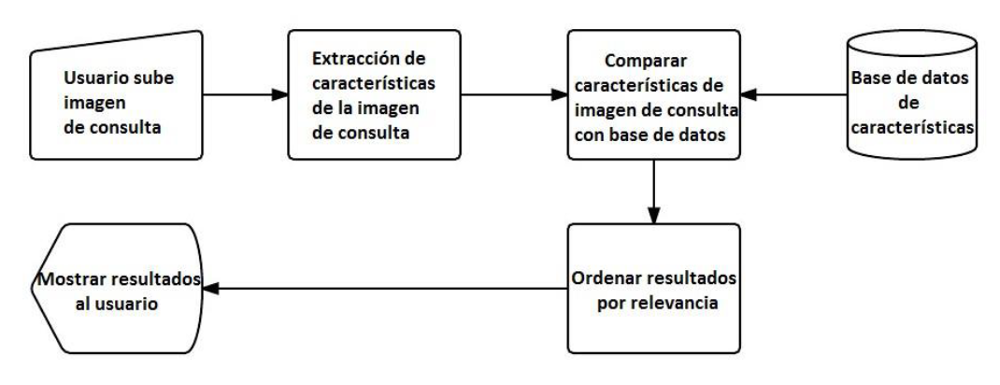


En primer lugar, importamos las librerías necesarias para el desarrollo del proyecto:

In [ ]:
import numpy as np
from IPython.display import clear_output 
import os
import cv2
from google.colab.patches import cv2_imshow
import random
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import Model
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tqdm import tqdm
import math
from scipy.spatial import distance
import numba as nb
import IPython
import time
import psutil

Luego, descargamos el dataset INRIA Holidays y lo ordenamos en una carpeta:

In [ ]:
!wget ftp://ftp.inrialpes.fr/pub/lear/douze/data/jpg1.tar.gz
!wget ftp://ftp.inrialpes.fr/pub/lear/douze/data/jpg2.tar.gz

--2022-12-03 23:39:08--  ftp://ftp.inrialpes.fr/pub/lear/douze/data/jpg1.tar.gz
           => ‘jpg1.tar.gz’
Resolving ftp.inrialpes.fr (ftp.inrialpes.fr)... 194.199.18.221
Connecting to ftp.inrialpes.fr (ftp.inrialpes.fr)|194.199.18.221|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==> PWD ... done.
==> TYPE I ... done.  ==> CWD (1) /pub/lear/douze/data ... done.
==> SIZE jpg1.tar.gz ... 1141827194
==> PASV ... done.    ==> RETR jpg1.tar.gz ... done.
Length: 1141827194 (1.1G) (unauthoritative)

jpg1.tar.gz         100%[===================>]   1.06G  7.45MB/s    in 2m 15s  

2022-12-03 23:41:25 (8.08 MB/s) - ‘jpg1.tar.gz’ saved [1141827194]

--2022-12-03 23:41:25--  ftp://ftp.inrialpes.fr/pub/lear/douze/data/jpg2.tar.gz
           => ‘jpg2.tar.gz’
Resolving ftp.inrialpes.fr (ftp.inrialpes.fr)... 194.199.18.221
Connecting to ftp.inrialpes.fr (ftp.inrialpes.fr)|194.199.18.221|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==

In [ ]:
# Crear carpeta
!mkdir /content/inria
# Descomprimir en carpetas creadas
!tar -xzvf /content/jpg1.tar.gz -C /content/inria/ 
!tar -xzvf /content/jpg2.tar.gz -C /content/inria/ 
clear_output()

Descargamos y descomprimimos el General-Purpose Content-Based Images Retrieval dataset:

In [ ]:
!wget https://visual-computing.com/files/GPR1200/GPR1200.zip

--2022-12-03 23:45:35--  https://visual-computing.com/files/GPR1200/GPR1200.zip
Resolving visual-computing.com (visual-computing.com)... 159.69.224.23, 2a01:4f8:d0a:6527::2
Connecting to visual-computing.com (visual-computing.com)|159.69.224.23|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1247901539 (1.2G) [application/zip]
Saving to: ‘GPR1200.zip’

GPR1200.zip         100%[===================>]   1.16G  19.8MB/s    in 63s     

2022-12-03 23:46:39 (19.0 MB/s) - ‘GPR1200.zip’ saved [1247901539/1247901539]



In [ ]:
!unzip GPR1200.zip
clear_output()

Se separan las imágenes entre imágenes de consulta e imágenes de la base de datos. La lista *img_consulta* contiene todas las imágenes de consulta y la lista *img_BD* contiene todas las imágenes de la base de datos.

In [ ]:
img_consulta = []
img_BD_INRIA = []
directory_INRIA = '/content/inria/jpg'
INRIA_images_list = os.listdir(directory_INRIA)

for filename in INRIA_images_list:
  if filename.endswith('00.jpg'):
    img_consulta.append(filename)
  else:
    img_BD_INRIA.append(filename)

print('Imagenes de consulta: ' + str(len(img_consulta)))
print('Imagenes de base de datos: ' + str(len(img_BD_INRIA)))

Imagenes de consulta: 500
Imagenes de base de datos: 991


Por otro lado, creamos una lista *GPR1200* con todos los nombres de los archivos de la base de datos General-Purpose Content-Based Image Retrival. En este conjunto, todas las imágenes son a la vez de consulta y pertenecientes a la base de datos.

In [ ]:
directory_GPR = '/content/images'
GPR1200_DB = os.listdir(directory_GPR)
print('Imagenes base de datos GPR1200: ' + str(len(GPR1200_DB)))

Imagenes base de datos GPR1200: 12000


Para poder generar un sistema CBIR, se deben implementar métodos extractores de características. En este caso, se eligió Local Binary Pattern como método clásico y la red ResNet50 como red convolucional. A continuación se procede a implementar estos métodos para obtener un verctor de características de una imagen.

## **1. Obtención de vector de características:**

### **Extractor LBP:**

Creamos una clase LBP que permite leer una imagen y extraer su vector de características usando el método de Local Binary Pattern. Esta implementación consiste en lo siguiente:

* Se utiliza una matriz de 3x3 para trabajar la vecindad de cada píxel de la imagen, tal como se muestra en la siguiente matriz: 

$$\begin{array}{|c|c|c|}\hline
x_0 & x_1 & x_2 \\\hline
x_7 & c & x_3 \\\hline
x_6 & x_5 & x_4 \\\hline
\end{array}$$

* A cada elemento $x_{i}$ del contorno de la matriz, se le asigna el valor binario $s_{i}$, el cual permite generar la transformación:

\begin{equation}
   s_{i}= \begin{cases}
      1 \text{ si } x_{i}  \geq c\\
      0 \text{ si } x_{i}  < c
    \end{cases}\
\end{equation}
 
* Al valor central de la matriz ($c$) se le asigna el número:

$$c' = \sum_{i=0}^7s_{i}\cdot2^{7-i}$$

* Se itera sobre cada pixel de la imagen generando la misma transformación. 


Resulta importante mencionar que dada la naturaleza de la transformación, si se tiene de entrada una imagen de dimensiones $M\times N$, se obtendrá una imagen de dimensiones $(M-2) \times (N-2)$ ya que los pixeles de los bordes no alcanzan a formar una vecindad completa con 8 pixeles. 

Posterior al cálculo de la transformada LBP se realiza la extracción de características dividiendo la imagen transformada anteriormente en regiones de $100 \times 100$ pixeles y posteriormente calculando un histograma cuantizado en 89 barras de cada una de las regiones trabajadas y concatenandolo en un único vector, el cual es el vector de características resultante.

In [ ]:
class LBP():
  """Esta clase permite calcular el vector de características de una imagen ubicada
  en su respectivo directorio usando LBP"""

  def __init__(self, img_path):
    self.img = cv2.imread(img_path) #Lectura de la imagen en el directorio respectivo
    self.filename = img_path.split('/')[-1]

  def LBP_Grayscale(self):
    """Función que transforma la imagen a escala de grises y a una menor dimensión para 
    reducir tiempo de ejecución."""
    if len(self.img.shape) == 3:
      self.img = cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY)
      self.img = cv2.resize(self.img, (202,202))
    else: 
      pass
    return self.img

  def LBP_Matrix(self, matrix):
    """Función que se aplica sobre una matriz (ventana) de 3x3 y retorna el valor de la 
    transformada LBP del elemento central."""
    center = matrix[1][1] # centro de la matriz
    value = "" # valor de la transformacion (se inicializa en string porque se codifica como numero binario)
    for i in range(3):
      for j in range(3):
        if matrix[i][j] >= center:
          value += "1"
        else:
          value += "0"
    return int(value, 2) # decodificación de numero binario

  def LBP_Transf(self, plot=False):
    """Función para obtener la transformada LBP de una imagen utilizando dicho método"""
    self.img = self.LBP_Grayscale()
    x, y = self.img.shape
    LBPimg = np.zeros((x-2, y-2))
    for i in range(1,x-1):
        for j in range(1, y-1):
            mtx = self.img[i-1:i+2, j-1:j+2] #matriz que se procesa
            pixel = self.LBP_Matrix(mtx) # se obtiene valor LBP para bloque procesado
            LBPimg[i-1,j-1] = pixel #Se asigna el valor correspondiente.
    if plot:
      plt.figure(figsize=(6,5))
      plt.imshow(LBPimg, cmap='gray')
      plt.title(f'''Transformación LBP de la imagen {self.filename}''')
    return LBPimg #Se retorna la imagen LBP 

  def LBP_Charact(self, plot=False):
    """Se utiliza la imagen ya procesada con LBP y se extraen sus características 
    utilizando una ventana de 100x100, calculando su histograma cuantizado en 89 barras"""
    imgLBP = self.LBP_Transf() #Se llama a la imagen procesada ya con LBP
    m, n = imgLBP.shape
    vector_hist = []
    for i in range(0,m,100):
      for j in range(0,n,100):
        block = imgLBP[i:i+100, j:j+100]
        hist, edges = np.histogram(block, bins=89)
        for element in hist:
          vector_hist.append(element)
    vector_hist = np.array(vector_hist) # pasamos el vector a numpy array
    vector_hist = vector_hist/np.linalg.norm(vector_hist) # normalizamos el vector
    if plot:
      plt.plot(vector_hist)
      plt.title(f'''Histograma de imagen {self.filename} LBP para características extraidas''')
    return vector_hist

Ejemplos de transformaciones LBP y sus histogramas:

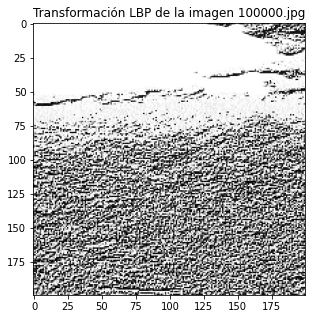

In [ ]:
img_path_1 = '/content/inria/jpg/100000.jpg'
LBP_1 = LBP(img_path_1).LBP_Transf(True)

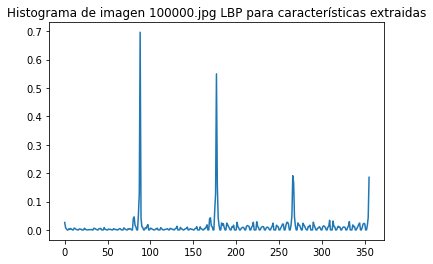

In [ ]:
charVec_1 = LBP(img_path_1).LBP_Charact(True)

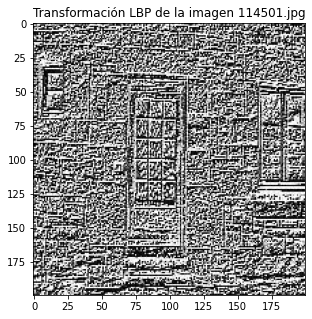

In [ ]:
img_path_2 = '/content/inria/jpg/114501.jpg'
LBP_2 = LBP(img_path_2).LBP_Transf(True)

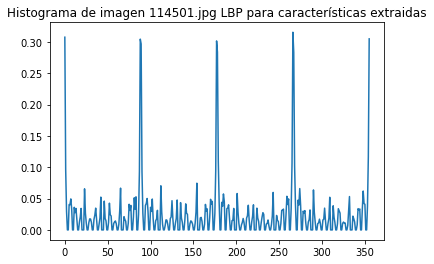

In [ ]:
charVec_2 = LBP(img_path_2).LBP_Charact(True)

### **Extractor CNN:**

Se hace uso de una red convolucional para obtener un segundo extractor de características. Se elige el modelo de ResNet50 pre-entrenado con imágenes del dataset ImageNet.

Se hace uso de las librerías TensorFlow/Keras para cargar el modelo y luego utilizar solo las capas de la red que permiten generar un vector de características a partir de una imagen, es decir, se seleccionan las capas anteriores a la red fully-connected que clasifica la imagen.

Para hacer uso de este modelo, se preprocesa la imagen a través de un redimensionamiento, cambio de configuración de colores de BGR a RGB y una expansión (de 1 dimensión) para trabajarla como tensor. Finalmente se hace uso del método *preprocess_input* definido por Keras para que la imagen pueda ser usada por la red neuronal y generar un vector de características.

Finalmente, con el objetivo de obtener una representación vectorial de la imagen, se hace uso de la función *predict* de Keras y luego normalizamos este vector de salida.

In [ ]:
resnet50 = ResNet50(include_top=False, weights='imagenet', pooling='max')
#resnet50.summary()

94765736/94765736 [==============================] - 0s 0us/step


In [ ]:
class CNN():
  def __init__(self, img_path, model):
    self.model = model
    self.img = cv2.imread(img_path)
  
  def CNN_process(self):
    if len(self.img.shape) == 3: 
      self.img = cv2.resize(self.img, (224,224)) #Redimensionar imagen
      self.img = cv2.cvtColor(self.img, cv2.COLOR_BGR2RGB) #Convertir a espacio RGB
      self.img = np.expand_dims(self.img, axis=0) #Añadir una dimensión para crear tensor
      self.img = preprocess_input(self.img) #Preprocess input de keras
    else: 
      pass
    return self.img

  def CNN_extract_features(self):
    self.img = self.CNN_process()
    features = self.model.predict(self.img, verbose = False)[0]
    norma = np.linalg.norm(features) #Se calcula la norma para normalizar el vector de características
    features_norm = features/norma #Se normaliza el vector de características
    return features_norm

Algunos ejemplos de vectores de características extraídos por ResNet50:

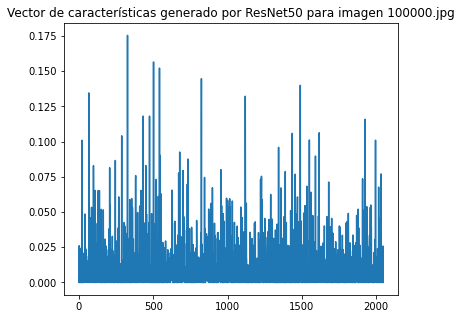

In [ ]:
CNNFeatures_1 = CNN(img_path_1, resnet50).CNN_extract_features()
plt.figure(figsize=(6,5))
plt.plot(CNNFeatures_1)
plt.title(f'''Vector de características generado por ResNet50 para imagen {os.path.basename(img_path_1)}''')
plt.show()

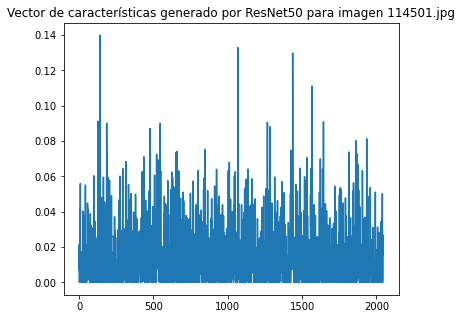

In [ ]:
CNNFeatures_2 = CNN(img_path_2, resnet50).CNN_extract_features()
plt.figure(figsize=(6,5))
plt.plot(CNNFeatures_2)
plt.title(f'''Vector de características generado por ResNet50 para imagen {os.path.basename(img_path_2)}''')
plt.show()

### **Extractor de caracteríaticas:**

Luego de haber implementado dos métodos para extraer características, se crea la función que permite extraer las características de una imagen específica utilizando un método en particular, ya sea "CNN" o "LBP". 

In [ ]:
def get_feature_vector(img_path, extractor, model=None): # extractor puede ser clasico o CNN
  assert extractor in ['LBP', 'CNN']
  if extractor == 'LBP':
    vector = LBP(img_path).LBP_Charact(False)
  elif extractor == 'CNN' and model:
    vector = CNN(img_path, model).CNN_extract_features()
  return vector

Aplicamos esta función a todas las imágenes de la base de datos INRIA para construir dos listas que contienen los vectores de características según el método utilizado: `LBP_feature_vectors` y `CNN_feature_vectors`.

In [ ]:
INRIA_LBP_feature_vectors = []
INRIA_CNN_feature_vectors = []

for img_name in tqdm(img_BD_INRIA): 
  img_path = os.path.join(directory_INRIA, img_name)

  lbp_vector = get_feature_vector(img_path, 'LBP')
  cnn_vector = get_feature_vector(img_path, 'CNN', resnet50)

  INRIA_LBP_feature_vectors.append(lbp_vector)
  INRIA_CNN_feature_vectors.append(cnn_vector)

clear_output()

De la misma forma, construimos listas con vectores de características de todas las imágenes de la base de datos GPR12000 generados con LBP o CNN. Registramos estos vectores en dos listas: `GPR_LBP_feature_vectors` y `GPR_CNN_feature_vectors`.

In [ ]:
#advertencia: esto se demora MUCHO en hacerse, alrededor de las horas
GPR_LBP_feature_vectors = []
GPR_CNN_feature_vectors = []

for img_name in tqdm(GPR1200_DB):
  
  img_path = os.path.join(directory_GPR, img_name)

  lbp_vector = get_feature_vector(img_path, 'LBP')
  cnn_vector = get_feature_vector(img_path, 'CNN', resnet50)

  GPR_LBP_feature_vectors.append(lbp_vector)
  GPR_CNN_feature_vectors.append(cnn_vector)

clear_output()

Verificamos que se obtuvieron correctamente todos los vectores de características de las imágenes de la base de datos.

In [ ]:
assert len(INRIA_LBP_feature_vectors) == 991, 'No todas las imágenes de INRIA fueron correctamente procesadas con el método LBP'
assert len(INRIA_CNN_feature_vectors) == 991, 'No todas las imágenes de INRIA fueron correctamente procesadas con el método CNN'

In [ ]:
assert len(GPR_LBP_feature_vectors) == 12000, 'No todas las imágenes de GPR12000 fueron correctamente procesadas con el método LBP'
assert len(GPR_CNN_feature_vectors) == 12000, 'No todas las imágenes de GPR12000 fueron correctamente procesadas con el método CNN'

## **2. Distancias:**

Se definen dos funciones para calcular medidas de similitud:

* Distancia Euclideana:

$$\mathrm{d}(x,y) = \sqrt{\sum_{i=1}^n(x_i-y_i)^{2}}$$

* Distancia Coseno:

$$\mathrm{d}(x,y) = \frac{\sum_{i=1}^n x_i \cdot y_i}{\sqrt{\sum_{i=1}^n{x_i^2}} \sqrt{\sum_{i=1}^n{y_i^2}}}$$

In [ ]:
import scipy
from scipy.spatial import distance
from scipy.spatial.distance import cdist
from sklearn.metrics.pairwise import euclidean_distances

def euclidean_dist(vec1, vec2):
    return np.sqrt(np.sum([(a-b)**2 for a,b in zip(vec1,vec2)]))

def cosine_dist(vec1, vec2):
    return distance.cosine(vec1,vec2)

## **3. Ordenar Distancias:**

Se desarrolla una función que compara, según la distancia especificada en los parámetros, una imagen de consulta (*img_query*) con cada una de las imágenes de la base de datos por medio de un vector de características, generado por el método especificado, y retorna una tupla donde el primer elemento es una lista con todas las distancias ordenadas y el segundo una lista con los índices de las imágenes en la base de datos ordenados según las distancias (esto se utilizará en un futuro para poder identificar qué distancia representa a cada imagen y así construír rankings y hacer plots).

In [ ]:
def get_distances(img_query_path, extractor, feature_vector_db, distance, model=None):
  '''Entrega una tupla de dos elementos donde el primero es un array ordenado con las distancias 
  entre el vector de características de una imagen de consulta y los vectores de características 
  de las imágenes de la base de datos según el método precisado en los parámetros y el segundo es
  una lista de los índices de las imágenes en la base de datos ordenados según las distancias.'''
  
  assert extractor in ['CNN', 'LBP']

  distances = []

  if extractor == 'LBP':
    feature_vector_img = LBP(img_query_path).LBP_Charact()
    for vector in feature_vector_db:
      dist = distance(feature_vector_img, vector)
      distances.append(dist)

  elif extractor == 'CNN' and model:
    feature_vector_img = CNN(img_query_path, model).CNN_extract_features()
    for vector in feature_vector_db:
      dist = distance(feature_vector_img, vector)
      distances.append(dist)

  sorted_index = np.array(distances).argsort()

  return np.array(sorted(distances)), sorted_index

## **4. Medidas y Ranking:**

 Se crea una lista ordenada de forma que las imágenes con mayor similitud (menor distancia) queden al inicio.

Se define el siguiente ranking con el objetivo de ordenar nuestros resultados por relevancia: 

$$Rank = \frac{1}{N_{rel}}\sum_{i=1}^{N_{rel}}R_{i}$$

*   $N_{rel}:$ Numero de imagenes relevantes para una imagen de consulta particular. Es el numero de imagenes de la base de datos que pertenecen a la misma clase que la imagen de consulta. 
*   $R_{i}:$ Corresponde a la posición de la i-ésima imagen relevante. Es decir, corresponde a la posición que obtienen las imágenes de una misma clase al calcular las distancias y ordenarlas (Se ordenan los valores de similitud de menor a mayor y se obtienen las posiciones de las imágenes de la misma clase que la imagen de consulta). 

Calculamos $N_{rel}$ y $Rank$:

In [ ]:
def get_nrel(imgs_database, img_query_name):
  clase_img_query = img_query_name[1:4]
  n_rel = 0
  for filename in imgs_database:
    clase = filename[1:4]
    if clase == clase_img_query:
      n_rel += 1
  return n_rel

def get_position_sum(sorted_index, imgs_database, img_query_name, show=False):
  # ordenamos los filenames según el parámetro sorted_index que contiene los índices 
  # correspondientes a las distancias ordenadas de menor a mayor
  sorted_filenames = np.array(imgs_database)[sorted_index]
  suma_posiciones = 0
  clase_img_query = img_query_name[1:4]
  for i in range(len(sorted_filenames)):
    pos = i+1
    filename = sorted_filenames[i]
    clase = filename[1:4]
    if clase == clase_img_query:
      suma_posiciones += pos
      if show:
        print('Clase: ',clase,'-- Posición: ', pos)
  return suma_posiciones

def get_rank(n_rel, suma_pos):
  return suma_pos/n_rel

Probamos el método para LBP y CNN:

In [ ]:
distances_LBP, sorted_index_LBP = get_distances(img_path_1, 'LBP', INRIA_LBP_feature_vectors, euclidean_dist)
n_rel_LBP = get_nrel(img_BD_INRIA, '100000.jpg')
sum_pos_LBP = get_position_sum(sorted_index_LBP, img_BD_INRIA, '100000.jpg', True)
rank_LBP = get_rank(n_rel_LBP, sum_pos_LBP)
print(rank_LBP)

Clase:  000 -- Posición:  15
Clase:  000 -- Posición:  272
143.5


In [ ]:
distances_CNN, sorted_index_CNN = get_distances(img_path_1, 'CNN', INRIA_CNN_feature_vectors, euclidean_dist, resnet50)
n_rel_CNN = get_nrel(img_BD_INRIA, '100000.jpg')
sum_pos_CNN = get_position_sum(sorted_index_CNN, img_BD_INRIA, '100000.jpg', True)
rank_CNN = get_rank(n_rel_CNN, sum_pos_CNN)
print(rank_CNN)

Clase:  000 -- Posición:  1
Clase:  000 -- Posición:  4
2.5


## **5. Ranking Normalizado:**

Se calcula la métrica "Rank Normalizado", definida por la ecuación:

$$\widehat{Rank} = \frac{1}{N \cdot N_{rel}}\left(\sum_{i=1}^{N_{rel}}R_{i}-\frac{N_{rel}(N_{rel}+1)}{2}\right)$$

* $N:$ Es el tamaño total del conjunto de imagenes.

($N_{rel}$ y $R_i$ definido previamente)

In [ ]:
def get_norm_rank(n, n_rel, suma_pos):
  prod_n = n*n_rel
  arg = suma_pos - (n_rel*(n_rel+1)/2)
  return arg/prod_n

Probamos el método para LBP y CNN

In [ ]:
n = len(img_BD_INRIA)
norm_rank_LBP = get_norm_rank(n, n_rel_LBP, sum_pos_LBP)
print('Ranking Normalizado usando método LBP:')
print(norm_rank_LBP)

Ranking Normalizado usando método LBP:
0.1432896064581231


In [ ]:
norm_rank_CNN = get_norm_rank(n, n_rel_CNN, sum_pos_CNN)
print('Ranking Normalizado usando método CNN:')
print(norm_rank_CNN)

Ranking Normalizado usando método CNN:
0.0010090817356205853


Probamos el conjunto de los dos rankings, usando los dos métodos diferentes para una nueva imagen:

In [ ]:
imgQuery = '/content/inria/jpg/103100.jpg'
dist_LBP, sort_idx_LBP = get_distances(imgQuery, 'LBP', INRIA_LBP_feature_vectors, euclidean_dist)
dist_CNN, sort_idx_CNN = get_distances(imgQuery, 'CNN', INRIA_CNN_feature_vectors, euclidean_dist, resnet50)
n_rel_imgQuery = get_nrel(img_BD_INRIA, '103100.jpg')
print('Clase y Posición LBP:')
sum_pos_LBP_imgQuery = get_position_sum(sort_idx_LBP, img_BD_INRIA, '103100.jpg', True)
print('\nClase y Posición CNN:')
sum_pos_CNN_imgQuery = get_position_sum(sort_idx_CNN, img_BD_INRIA, '103100.jpg', True)

# LBP
print('\n')
rank_LBP_imgQuery = get_rank(n_rel_imgQuery, sum_pos_LBP_imgQuery)
print('Ranking para la imagen 103100 usando método LBP:')
print(rank_LBP_imgQuery)

norm_rank_LBP_imgQuery = get_norm_rank(n, n_rel_imgQuery, sum_pos_LBP_imgQuery)
print('Ranking Normalizado para la imagen 103100 usando método LBP:')
print(norm_rank_LBP_imgQuery)
print('\n')


# CNN
rank_CNN_imgQuery = get_rank(n_rel_imgQuery, sum_pos_CNN_imgQuery)
print('Ranking para la imagen 103100 usando método CNN:')
print(rank_CNN_imgQuery)

norm_rank_CNN_imgQuery = get_norm_rank(n, n_rel_imgQuery, sum_pos_CNN_imgQuery)
print('Ranking Normalizado para la imagen 103100 usando método CNN:')
print(norm_rank_CNN_imgQuery)

Clase y Posición LBP:
Clase:  031 -- Posición:  1
Clase:  031 -- Posición:  5

Clase y Posición CNN:
Clase:  031 -- Posición:  1
Clase:  031 -- Posición:  3


Ranking para la imagen 103100 usando método LBP:
3.0
Ranking Normalizado para la imagen 103100 usando método LBP:
0.0015136226034308778


Ranking para la imagen 103100 usando método CNN:
2.0
Ranking Normalizado para la imagen 103100 usando método CNN:
0.0005045408678102926


Creamos una función que obtiene las métricas para cada consulta:

In [ ]:
def metricasConsulta(img_query_path, imgs_database, index_LBP, index_CNN, n, show = False):
  #Calculo de imagenes relevantes para consulta
  img_query_name = os.path.basename(img_query_path)
  print('Métricas de Consulta para imagen: ' + img_query_name)
  nrel = get_nrel(imgs_database, img_query_name)
  #Calculo de posiciones según valores
  print('\nPosiciones LBP')
  ri_LBP = get_position_sum(index_LBP, imgs_database, img_query_name, show)
  print('\nPosiciones CNN')
  ri_CNN = get_position_sum(index_CNN, imgs_database, img_query_name, show)
  #Rank
  rank_LBP = get_rank(nrel, ri_LBP)
  rank_CNN = get_rank(nrel, ri_CNN)
  #Rank normalizado
  rank_norm_LBP = get_norm_rank(n, nrel, ri_LBP)
  rank_norm_CNN = get_norm_rank(n, nrel, ri_CNN)

  if show:
    print('\nRank LBP: ', rank_LBP) 
    print('Rank CNN: ', rank_CNN) 
    print('Rank normalizado LBP: ', rank_norm_LBP) 
    print('Rank normalizado CNN: ', rank_norm_CNN) 

## **6. Plot Imágenes:**

Se crea una función que permite hacer un `plot` de una cierta cantidad de imágenes (especificada en los parámetros) mejor rankeada según un método específico.

Esta función recibe la **ruta relativa a la imagen**, la **lista de distancias ordenadas**, la **lista de índices de imágenes ordenado por distancias**, la **base de datos a usar**, el **directorio del dataset correspondiente** y el **número de imágenes a plotear**.

###Función para plottear imagenes y diseño de la función para la consulta

In [ ]:
import math

def plot_imagenes(img_query_path, sorted_distances, sorted_index, imgs_BD, directory, n_plot=10):
  
  sorted_filenames = np.array(imgs_BD)[sorted_index]
  imgs_to_plot = sorted_filenames[:n_plot]

  n_rows = math.floor((n_plot+1)/3 + 1)
  img_query = cv2.imread(img_query_path)
  plt.figure(figsize=(20, 30))
  plt.subplot(n_rows, 3, 1)
  plt.imshow(img_query)
  plt.title(f'''Imagen de consulta {os.path.basename(img_query_path)}''')

  for i in range(n_plot):
    filename = imgs_to_plot[i]
    distance = sorted_distances[i]
    img_path = os.path.join(directory, filename)
    img = cv2.imread(img_path)
    plt.subplot(n_rows, 3, i+2)
    plt.imshow(img)
    plt.title('Imagen: ' + filename + ' Distancia: ' + str(distance))

  plt.show()


Definimos la función `query` que permite hacer consultas a la base de datos. Esta función recibe como parámetros el **nombre de la imagen**, el **el modelo a utilizar** ('CNN' o 'LBP'), la **lista de vectores de características**, el **directorio del dataset corerespondiente**, la **distancia a utilizar** y en caso de usar 'CNN', la **red a utilizar**.

In [ ]:
def query(img_name, modelo, feature_vectors, directory, distancia, net=resnet50):
    img_query_path = os.path.join(directory, img_name)
    if modelo == "LBP":
        LBP_dist, sorted_idx_LBP = get_distances(img_query_path, 'LBP', feature_vectors, distancia)
        return {'img_query_path': img_query_path, 'dist': LBP_dist, 'sorted_idx': sorted_idx_LBP}
    elif modelo == "CNN":
        CNN_dist, sorted_idx_CNN = get_distances(img_query_path, 'CNN', feature_vectors, distancia, net)
        return {'img_query_path': img_query_path, 'dist': CNN_dist, 'sorted_idx': sorted_idx_CNN}

Querys para el dataset INRIA:

In [ ]:
# Distancia euclideana:
dict_1_lbp = query('102300.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, euclidean_dist)
dict_1_cnn = query('102300.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, euclidean_dist)

dict_2_lbp = query('103100.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, euclidean_dist)
dict_2_cnn = query('103100.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, euclidean_dist)


# Distancia coseno
dict_1_lbp_cos = query('102300.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, distancia = cosine_dist)
dict_1_cnn_cos = query('102300.jpg', "CNN", INRIA_CNN_feature_vectors, directory_INRIA, distancia = cosine_dist)

dict_2_lbp_cos = query('103100.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, distancia = cosine_dist)
dict_2_cnn_cos = query('103100.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, distancia = cosine_dist)

Querys para Dataset GPR1200:

In [ ]:
# Distancia euclideana:
GPR_dict_1_lbp = query('1002_nm1404488_rm3253067264_1991-4-10_2013.jpg', 'LBP', GPR_LBP_feature_vectors, directory_GPR, euclidean_dist)
GPR_dict_1_cnn = query('1002_nm1404488_rm3253067264_1991-4-10_2013.jpg', 'CNN', GPR_CNN_feature_vectors, directory_GPR, euclidean_dist)

GPR_dict_2_lbp = query('1043_nm0000132_rm667534848_1979-4-12_2014.jpg', 'LBP', GPR_LBP_feature_vectors, directory_GPR, euclidean_dist)
GPR_dict_2_cnn = query('1043_nm0000132_rm667534848_1979-4-12_2014.jpg', 'CNN', GPR_CNN_feature_vectors, directory_GPR, euclidean_dist)


# Distancia coseno
GPR_dict_1_lbp_cos = query('1002_nm1404488_rm3253067264_1991-4-10_2013.jpg', 'LBP', GPR_LBP_feature_vectors, directory_GPR, cosine_dist)
GPR_dict_1_cnn_cos = query('1002_nm1404488_rm3253067264_1991-4-10_2013.jpg', "CNN", GPR_CNN_feature_vectors, directory_GPR, cosine_dist)

GPR_dict_2_lbp_cos = query('1043_nm0000132_rm667534848_1979-4-12_2014.jpg', 'LBP', GPR_LBP_feature_vectors, directory_GPR, cosine_dist)
GPR_dict_2_cnn_cos = query('1043_nm0000132_rm667534848_1979-4-12_2014.jpg', 'CNN', GPR_CNN_feature_vectors, directory_GPR, cosine_dist)

### **Distancia Euclideana en Dataset INRIA:**

Hacemos un plot para las imágenes 102300.jpg y 103100.jpg con métodos LBP y CNN utilizando la distancia euclideana como métrica: 

#### Pruebas LBP:

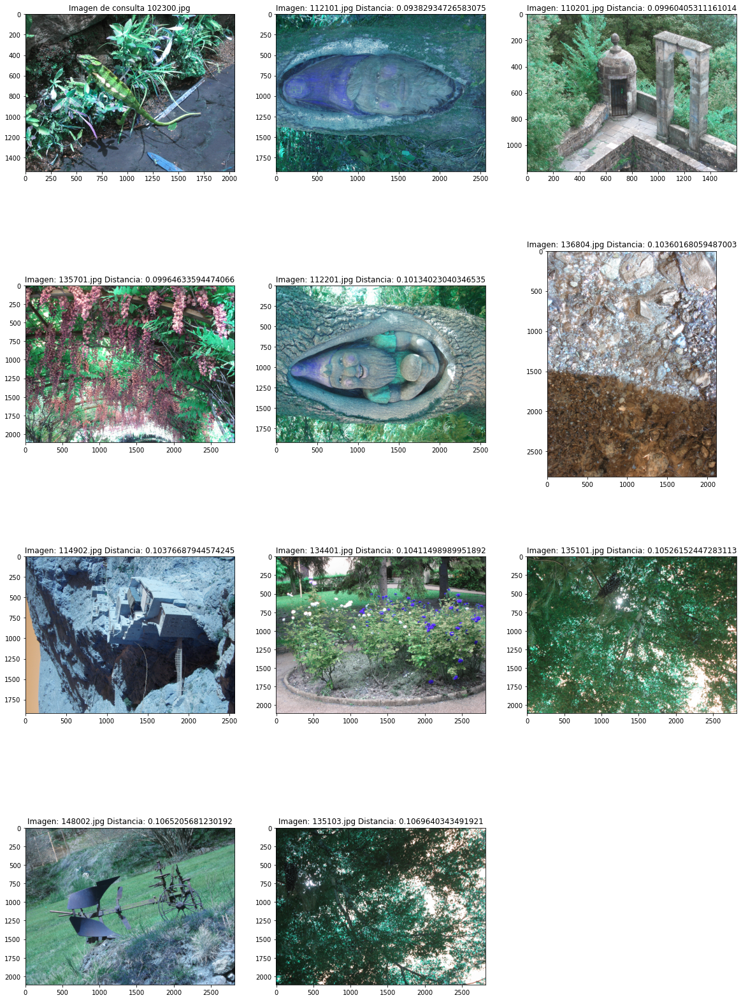

In [ ]:
plot_imagenes(dict_1_lbp['img_query_path'], dict_1_lbp['dist'], dict_1_lbp['sorted_idx'], img_BD_INRIA, directory_INRIA)

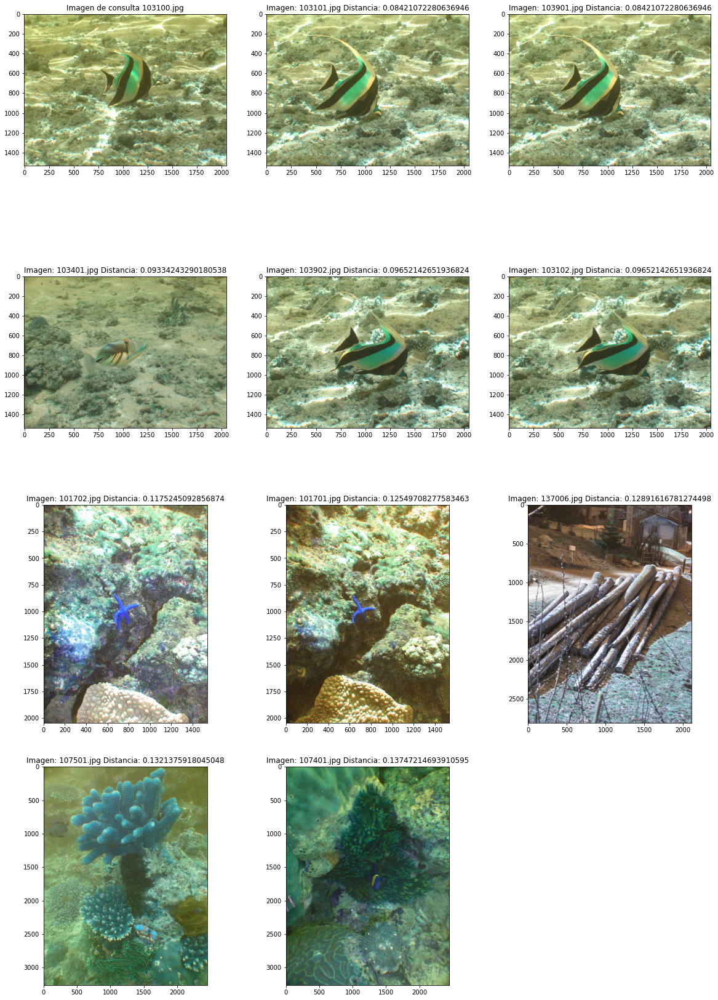

In [ ]:
plot_imagenes(dict_2_lbp['img_query_path'], dict_2_lbp['dist'], dict_2_lbp['sorted_idx'], img_BD_INRIA, directory_INRIA)

Para la primera imagen de consulta se puede notar que si bien la imagen con menor distancia es un gnomo en un árbol, esta última de todas formas tiene colores y una ambientación similar a la imagen de consulta, en el sentido de que ambas tienen colores verdosos y ambas tienen vegetación de fondo. En general todas las imágenes obtenidas de la consulta tienen colores similares a la de consulta, con algunas excepciones. Lo ideal habría sido obtener otra foto con un lagarto o que las imágenes de vegetación tengan menor distancia, sin embargo para un algoritmo que no necesita entrenamiento ni técnicas de deep learning en general, no está tan mal.

Con respecto a la segunda imagen de consulta, las imágenes obtenidas son tremendamente similares a la de consulta, inclusive 4 de las imágenes obtenidas son la misma imagen de consulta pero rotada o con el pez mirando en otras direcciones. La única imagen que no tiene mucho que ver con los resultados de la consulta es la de los troncos, pero si se ignora esa, todas las demás son de al menos ambientes submarinos, implicando que esta vez el método fue efectivo, a diferencia de la imagen de consulta anterior

#### Pruebas CNN:

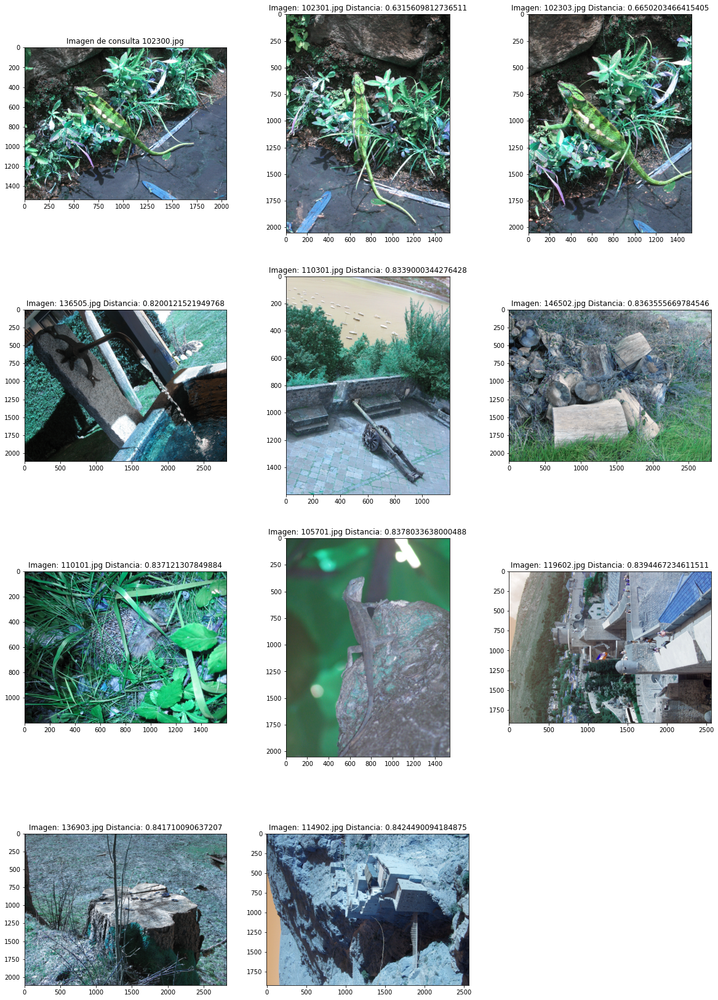

In [ ]:
plot_imagenes(dict_1_cnn['img_query_path'], dict_1_cnn['dist'], dict_1_cnn['sorted_idx'], img_BD_INRIA, directory_INRIA)

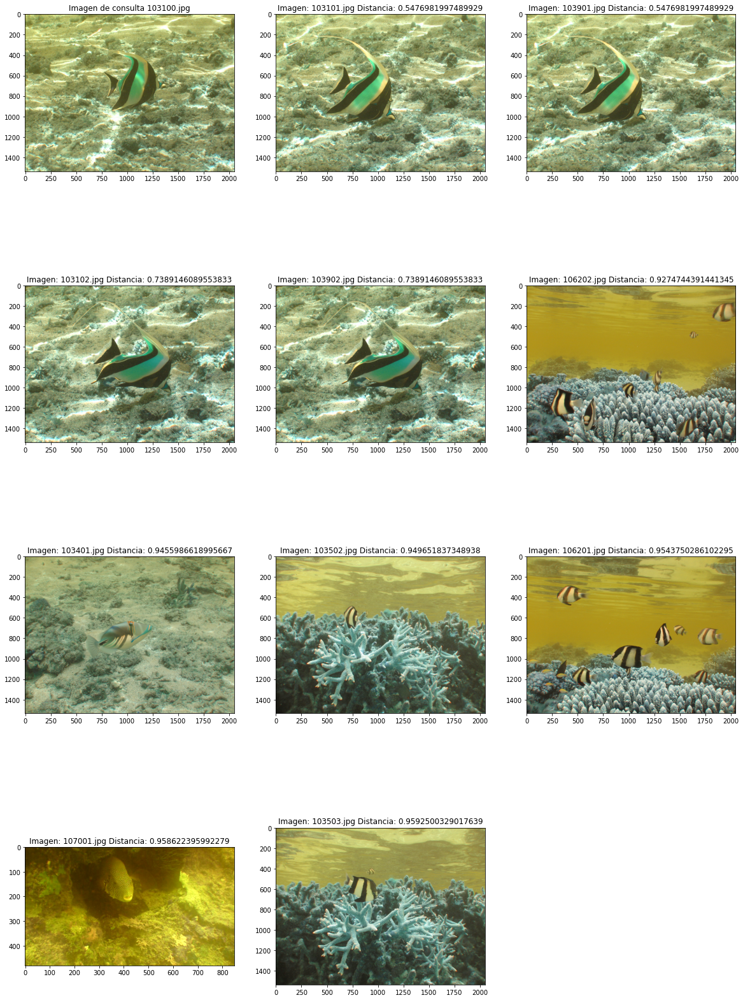

In [ ]:
plot_imagenes(dict_2_cnn['img_query_path'], dict_2_cnn['dist'], dict_2_cnn['sorted_idx'], img_BD_INRIA, directory_INRIA)

Ahora con la CNN se pueden ver directamente resultados mucho mejores con respecto al método LBP, ya que las primeras imágenes de consulta 1 son la misma imagen de consulta pero rotada o con zoom, mientras que las demas imágenes calzan con tener un cuerpo al centro rodeado de vegetación.

Con respecto a la segunda consulta con CNN, se puede ver que todas las imágenes obtenidas son imágenes de la misma especie de pez pero con distintas posiciones y  ambientes. De los resultados obtenidos se puede directamente decir que la CNN es superior a LBP en cuanto de mostrar imágenes similares

#### Comparación LBP y CNN:

In [ ]:
metricasConsulta(dict_1_lbp['img_query_path'], img_BD_INRIA, dict_1_lbp['sorted_idx'], dict_1_cnn['sorted_idx'], len(img_BD_INRIA), True)

Métricas de Consulta para imagen: 102300.jpg

Posiciones LBP
Clase:  023 -- Posición:  90
Clase:  023 -- Posición:  126
Clase:  023 -- Posición:  199

Posiciones CNN
Clase:  023 -- Posición:  1
Clase:  023 -- Posición:  2
Clase:  023 -- Posición:  11

Rank LBP:  138.33333333333334
Rank CNN:  4.666666666666667
Rank normalizado LBP:  0.13757147662293978
Rank normalizado CNN:  0.0026908846283215607


In [ ]:
metricasConsulta(dict_2_lbp['img_query_path'], img_BD_INRIA, dict_2_lbp['sorted_idx'], dict_2_cnn['sorted_idx'], len(img_BD_INRIA), True)

Métricas de Consulta para imagen: 103100.jpg

Posiciones LBP
Clase:  031 -- Posición:  1
Clase:  031 -- Posición:  5

Posiciones CNN
Clase:  031 -- Posición:  1
Clase:  031 -- Posición:  3

Rank LBP:  3.0
Rank CNN:  2.0
Rank normalizado LBP:  0.0015136226034308778
Rank normalizado CNN:  0.0005045408678102926


Con respecto a los rankings para la primera consulta, se puede ver que LBP tiene un ranking normalizado varios ordenes de magnitud mayor que el de CNN, implicando que la CNN esta poniendo las imagenes buscadas en primeras posiciones, cosa que se puede comprobar en los gráficos anteriores, mientras que el método LBP tiene mucha mas aleatoreidad asociada a diferencia de la CNN.

Con respecto a la imagen de consulta 2, los rankings normalizados son cercanos a 0 tanto para el metodo LBP como para CNN, sin embargo se repite que la CNN tiene un ranking normalizado mucho mas bajo que el de LBP. Se reafirma la conclusión que el método de CNN es mucho mejor que LBP para mostrar las imágenes de la consulta.

### **Distancia Coseno en Dataset INRIA**:

Hacemos un plot para las imágenes 102300.jpg y 103100.jpg con métodos LBP y CNN utilizando la distancia coseno como métrica: 

#### Pruebas LBP:

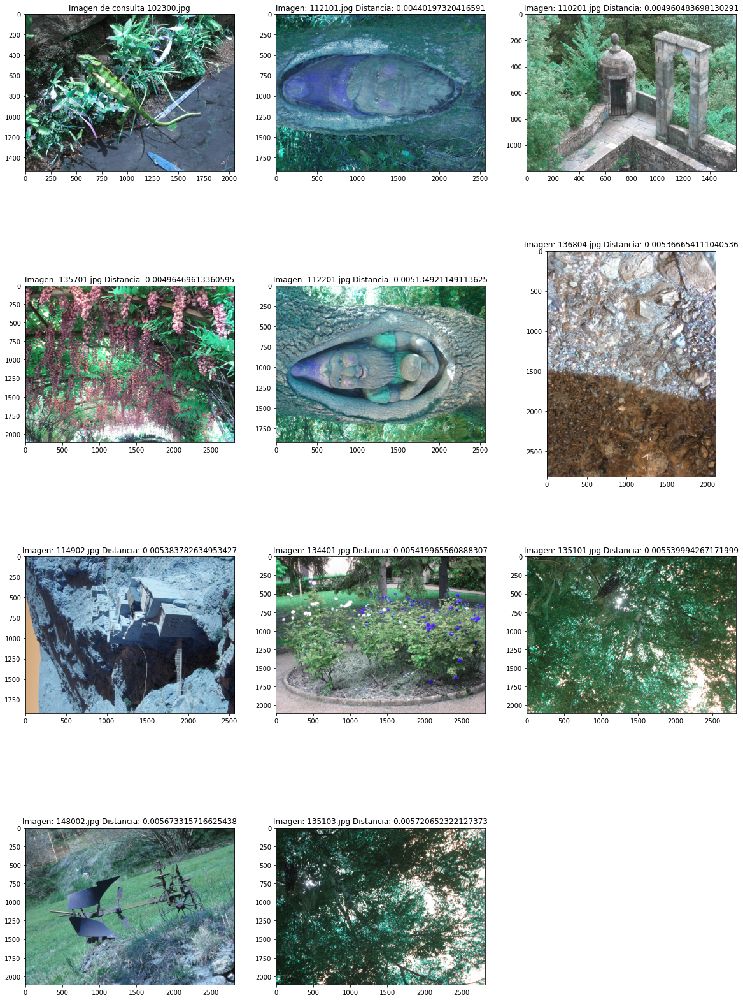

In [ ]:
plot_imagenes(dict_1_lbp_cos['img_query_path'], dict_1_lbp_cos['dist'], dict_1_lbp_cos['sorted_idx'], img_BD_INRIA, directory_INRIA)

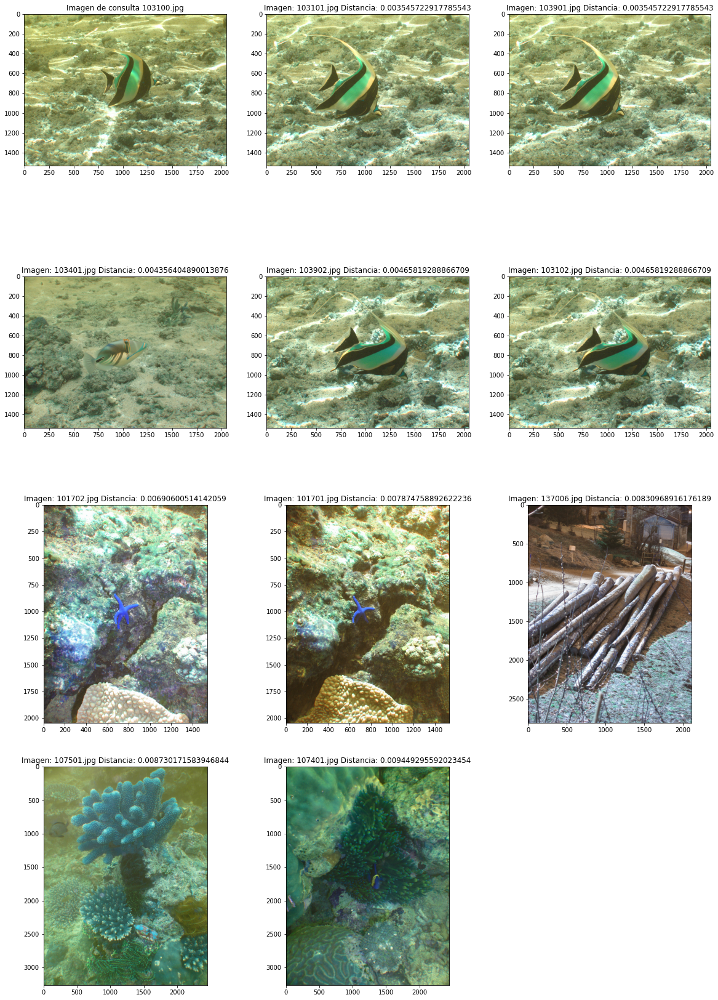

In [ ]:
plot_imagenes(dict_2_lbp_cos['img_query_path'], dict_2_lbp_cos['dist'], dict_2_lbp_cos['sorted_idx'], img_BD_INRIA, directory_INRIA)

Ahora para la distancia coseno, con el método LBP se obtienen exactamente los mismos resultados que se obtuvieron con la distancia euclidiana, por lo tanto el análisis es el mismo: el método LBP no tiene resultados imagenes similares a la de un lagarto rodeado de flores, aun cuando se emplea otro tipo de distancia. Naturalmente, las distancias asociadas a cada imagen son diferentes a las obtenidas en la parte con distancia euclidiana debido a que se utiliza otra metrica de distancias.


#### Pruebas CNN:

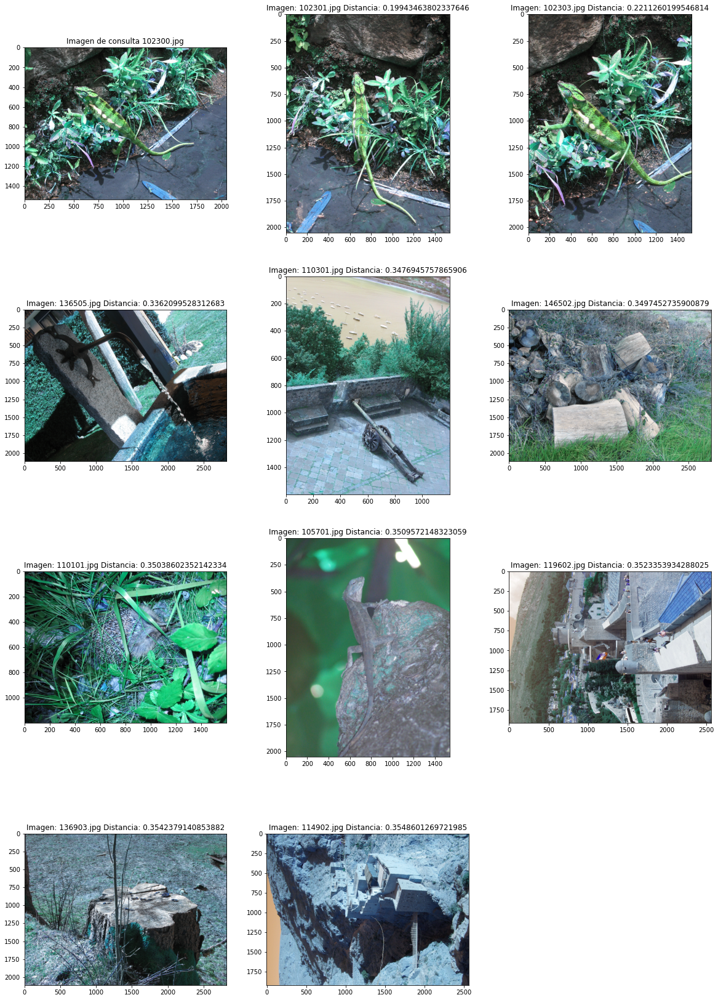

In [ ]:
plot_imagenes(dict_1_cnn_cos['img_query_path'], dict_1_cnn_cos['dist'], dict_1_cnn_cos['sorted_idx'], img_BD_INRIA, directory_INRIA)

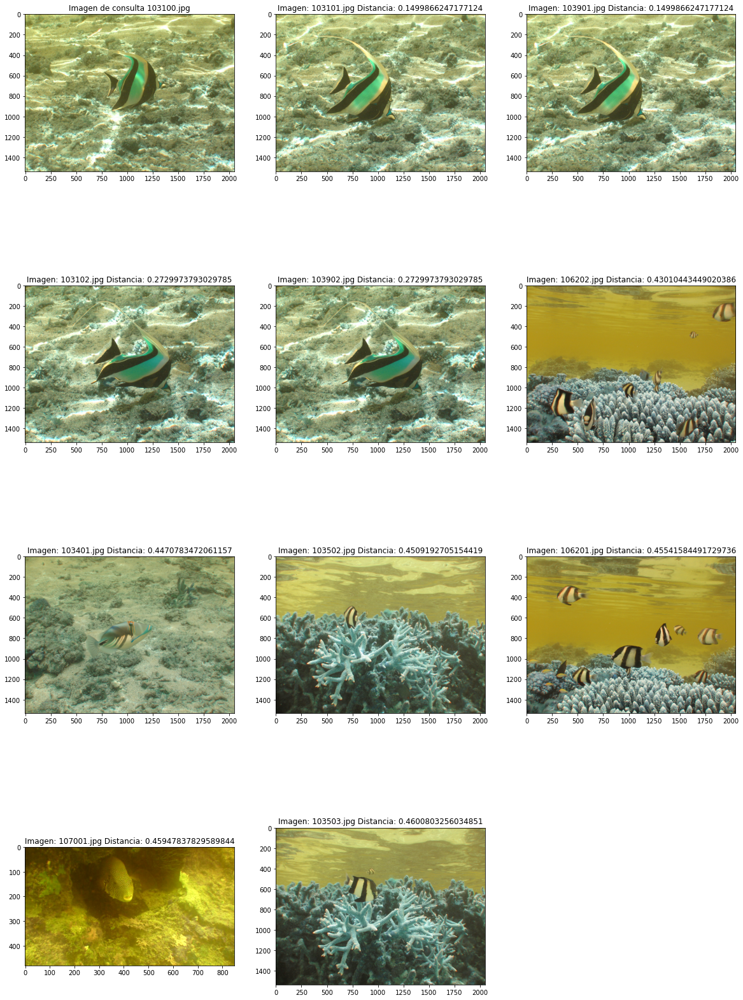

In [ ]:
plot_imagenes(dict_2_cnn_cos['img_query_path'], dict_2_cnn_cos['dist'], dict_2_cnn_cos['sorted_idx'], img_BD_INRIA, directory_INRIA)

Nuevamente, los resultados obtenidos con la distancia coseno con el método CNN son identicos a los obtenidos con la distancia euclidana. Lo interesante esta en que como los resultados son idénticos, implicaría que uno puede escoger cualquiera de las dos distancias, sin embargo también se deben tener en cuenta los costes computacionales asociados a estas.

#### Comparación LBP y CNN:

In [ ]:
metricasConsulta(dict_1_lbp_cos['img_query_path'], img_BD_INRIA, dict_1_lbp_cos['sorted_idx'], dict_1_cnn_cos['sorted_idx'], len(img_BD_INRIA), True)

Métricas de Consulta para imagen: 102300.jpg

Posiciones LBP
Clase:  023 -- Posición:  90
Clase:  023 -- Posición:  126
Clase:  023 -- Posición:  199

Posiciones CNN
Clase:  023 -- Posición:  1
Clase:  023 -- Posición:  2
Clase:  023 -- Posición:  11

Rank LBP:  138.33333333333334
Rank CNN:  4.666666666666667
Rank normalizado LBP:  0.13757147662293978
Rank normalizado CNN:  0.0026908846283215607


In [ ]:
metricasConsulta(dict_2_lbp_cos['img_query_path'], img_BD_INRIA, dict_2_lbp_cos['sorted_idx'], dict_2_cnn_cos['sorted_idx'], len(img_BD_INRIA), True)

Métricas de Consulta para imagen: 103100.jpg

Posiciones LBP
Clase:  031 -- Posición:  1
Clase:  031 -- Posición:  5

Posiciones CNN
Clase:  031 -- Posición:  1
Clase:  031 -- Posición:  3

Rank LBP:  3.0
Rank CNN:  2.0
Rank normalizado LBP:  0.0015136226034308778
Rank normalizado CNN:  0.0005045408678102926


Para finalizar el análisis de la distancia coseno, los rankings obtenidos para ambos métodos son iguales a los obtenidos para la distancia euclidiana, reafirmandose una vez mas la creencia de que la decisión de utilizar coseno o euclidiana recaerá netamente en el tiempo de computación que estas requieran.

### **Distancia Euclideana en Dataset GPR12000:**

Hacemos un plot para las imágenes 1002_nm1404488_rm3253067264_1991-4-10_2013.jpg y 1043_nm0000132_rm667534848_1979-4-12_2014.jpg con métodos LBP y CNN utilizando la distancia euclideana como métrica: 

#### Pruebas LBP:

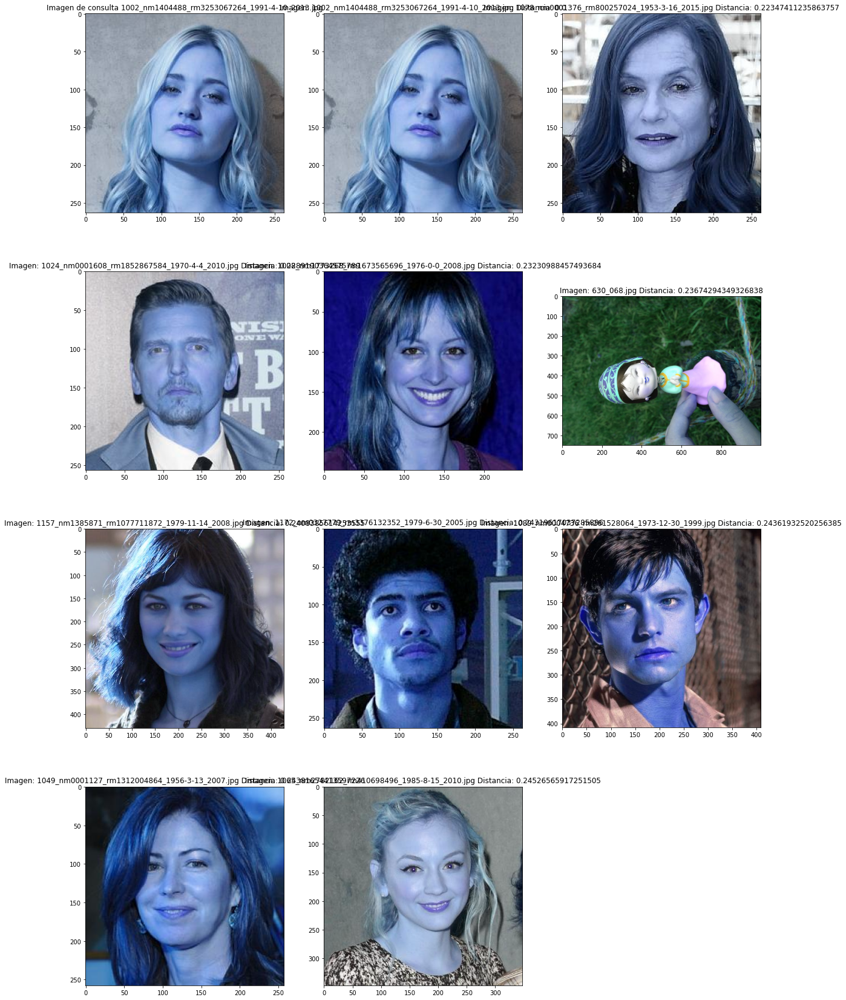

In [ ]:
plot_imagenes(GPR_dict_1_lbp['img_query_path'], GPR_dict_1_lbp['dist'], GPR_dict_1_lbp['sorted_idx'], GPR1200_DB, directory_GPR)

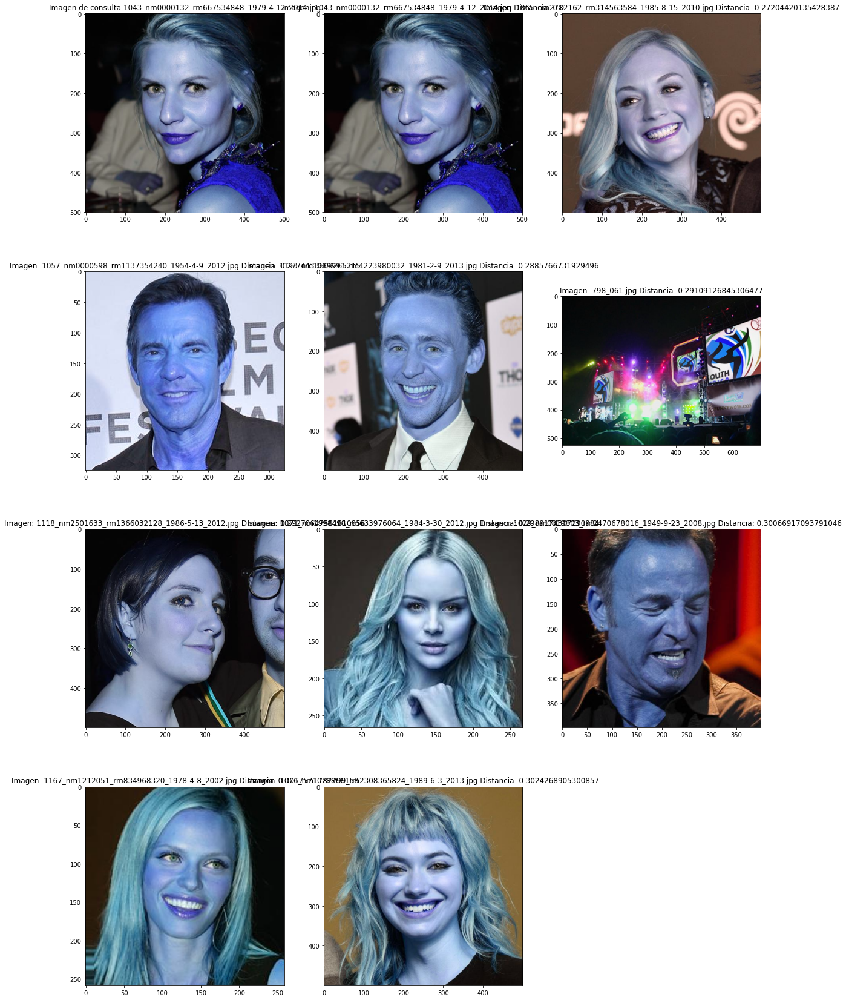

In [ ]:
plot_imagenes(GPR_dict_2_lbp['img_query_path'], GPR_dict_2_lbp['dist'], GPR_dict_2_lbp['sorted_idx'], GPR1200_DB, directory_GPR)

#### Pruebas CNN:

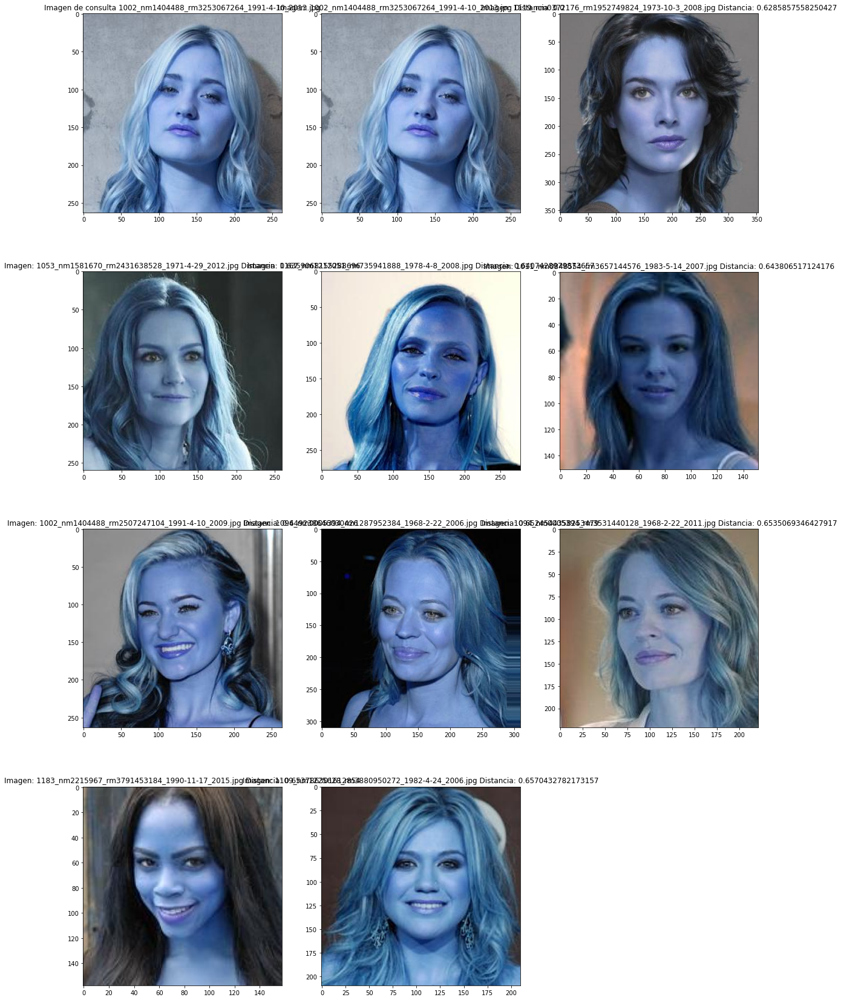

In [ ]:
plot_imagenes(GPR_dict_1_cnn['img_query_path'], GPR_dict_1_cnn['dist'], GPR_dict_1_cnn['sorted_idx'], GPR1200_DB, directory_GPR)

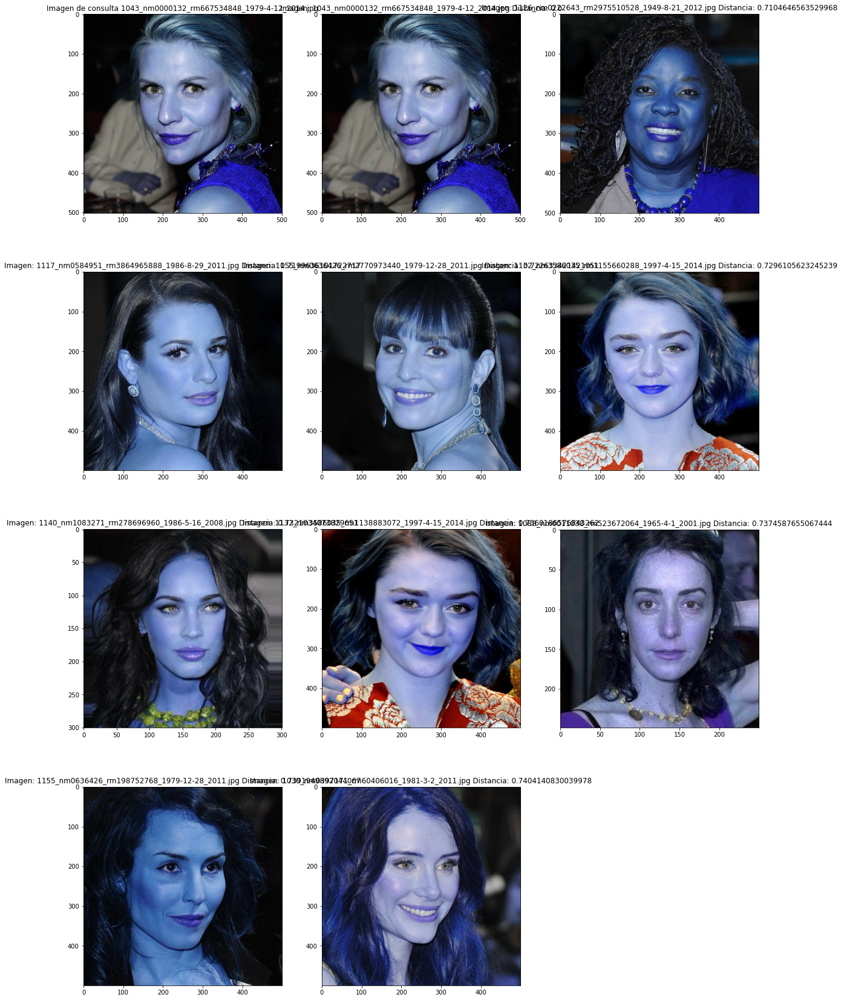

In [ ]:
plot_imagenes(GPR_dict_2_cnn['img_query_path'], GPR_dict_2_cnn['dist'], GPR_dict_2_cnn['sorted_idx'], GPR1200_DB, directory_GPR)

#### Comparación LBP y CNN:

In [ ]:
metricasConsulta(GPR_dict_1_lbp['img_query_path'], GPR1200_DB, GPR_dict_1_lbp['sorted_idx'], GPR_dict_1_cnn['sorted_idx'], len(GPR1200_DB), True)

Métricas de Consulta para imagen: 1002_nm1404488_rm3253067264_1991-4-10_2013.jpg

Posiciones LBP
Clase:  002 -- Posición:  1
Clase:  002 -- Posición:  14
Clase:  002 -- Posición:  165
Clase:  002 -- Posición:  328
Clase:  002 -- Posición:  1061
Clase:  002 -- Posición:  1191
Clase:  002 -- Posición:  2376
Clase:  002 -- Posición:  2541
Clase:  002 -- Posición:  2865
Clase:  002 -- Posición:  2917

Posiciones CNN
Clase:  002 -- Posición:  1
Clase:  002 -- Posición:  6
Clase:  002 -- Posición:  55
Clase:  002 -- Posición:  68
Clase:  002 -- Posición:  130
Clase:  002 -- Posición:  386
Clase:  002 -- Posición:  464
Clase:  002 -- Posición:  565
Clase:  002 -- Posición:  587
Clase:  002 -- Posición:  801

Rank LBP:  1345.9
Rank CNN:  306.3
Rank normalizado LBP:  0.1117
Rank normalizado CNN:  0.025066666666666668


In [ ]:
metricasConsulta(GPR_dict_2_lbp['img_query_path'], GPR1200_DB, GPR_dict_2_lbp['sorted_idx'], GPR_dict_2_cnn['sorted_idx'], len(GPR1200_DB), True)

Métricas de Consulta para imagen: 1043_nm0000132_rm667534848_1979-4-12_2014.jpg

Posiciones LBP
Clase:  043 -- Posición:  1
Clase:  043 -- Posición:  47
Clase:  043 -- Posición:  91
Clase:  043 -- Posición:  240
Clase:  043 -- Posición:  271
Clase:  043 -- Posición:  297
Clase:  043 -- Posición:  2331
Clase:  043 -- Posición:  2349
Clase:  043 -- Posición:  4910
Clase:  043 -- Posición:  10680

Posiciones CNN
Clase:  043 -- Posición:  1
Clase:  043 -- Posición:  32
Clase:  043 -- Posición:  55
Clase:  043 -- Posición:  181
Clase:  043 -- Posición:  236
Clase:  043 -- Posición:  273
Clase:  043 -- Posición:  350
Clase:  043 -- Posición:  435
Clase:  043 -- Posición:  499
Clase:  043 -- Posición:  1523

Rank LBP:  2121.7
Rank CNN:  358.5
Rank normalizado LBP:  0.17635
Rank normalizado CNN:  0.029416666666666667


Similarmente a lo ocurrido con el dataset INRIA Holidays, los resultados de métricas de rankings y rankings normalizados en el dataset GPR1200 son considerablemente mejores para el método CNN que para el método LBP. Aún cuando las imágenes utilizadas tienen tonalidades mucho mas distintas con respecto al dataset de INRIA, ya que estas ultimas son de paisajes y las del dataset GPR1200 son de personas

### **Distancia Coseno en Dataset GPR12000:**

Hacemos un plot para las imágenes 1002_nm1404488_rm3253067264_1991-4-10_2013.jpg y 1043_nm0000132_rm667534848_1979-4-12_2014.jpg con métodos LBP y CNN utilizando la distancia coseno como métrica: 

#### Pruebas LBP:

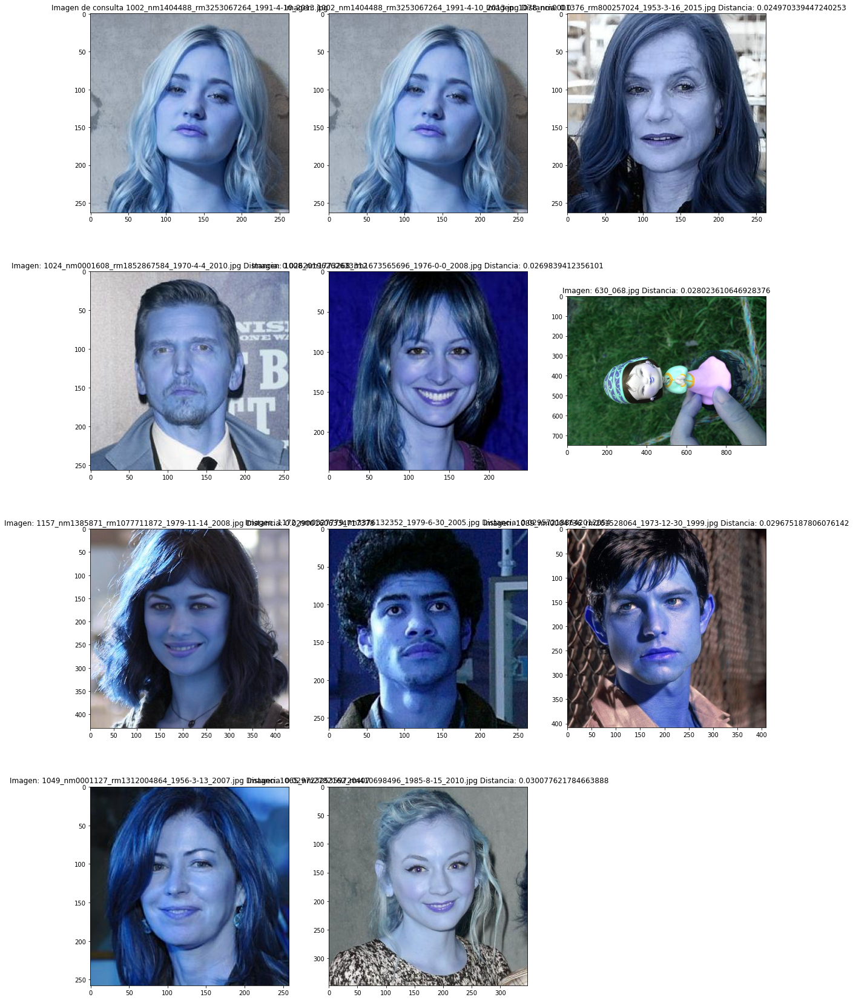

In [ ]:
plot_imagenes(GPR_dict_1_lbp_cos['img_query_path'], GPR_dict_1_lbp_cos['dist'], GPR_dict_1_lbp_cos['sorted_idx'], GPR1200_DB, directory_GPR)

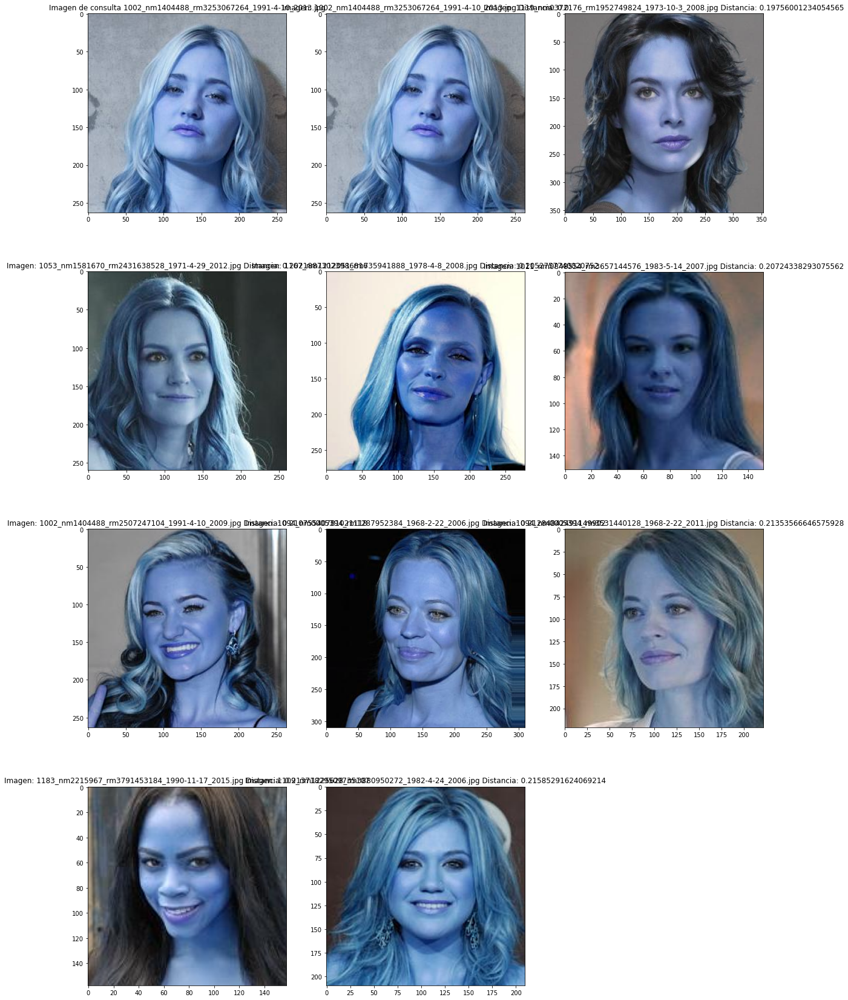

In [ ]:
plot_imagenes(GPR_dict_1_cnn_cos['img_query_path'], GPR_dict_1_cnn_cos['dist'], GPR_dict_1_cnn_cos['sorted_idx'], GPR1200_DB, directory_GPR)

#### Pruebas CNN:

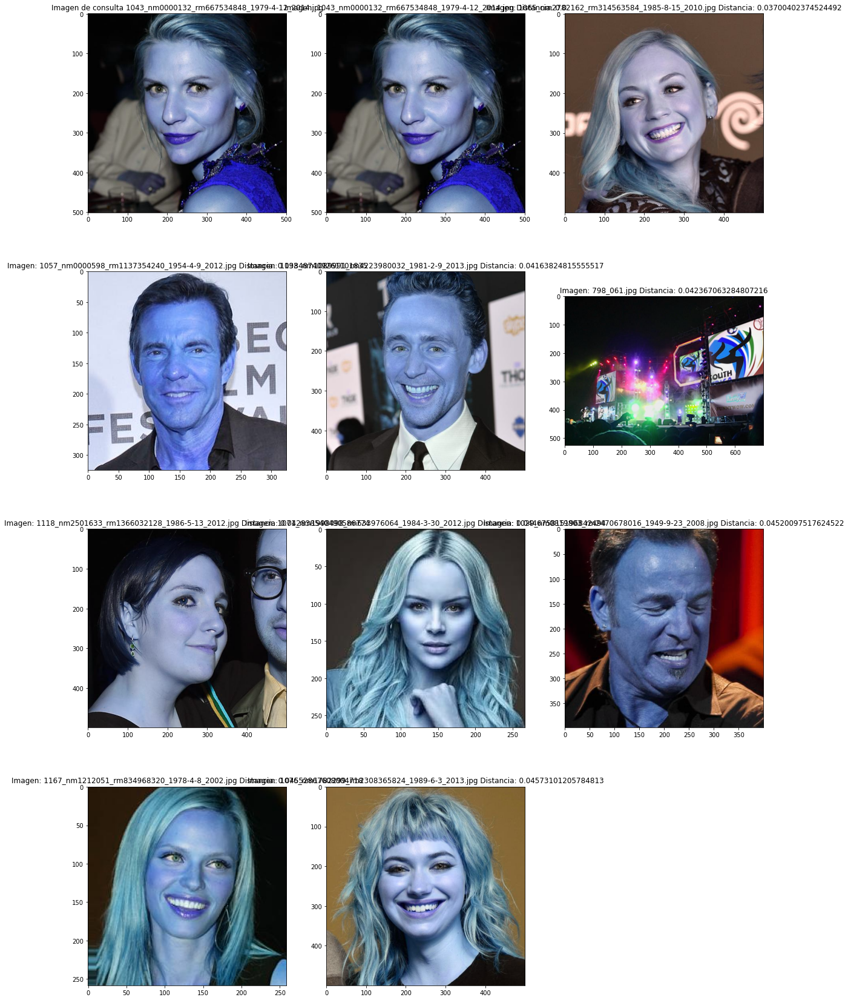

In [ ]:
plot_imagenes(GPR_dict_2_lbp_cos['img_query_path'], GPR_dict_2_lbp_cos['dist'], GPR_dict_2_lbp_cos['sorted_idx'], GPR1200_DB, directory_GPR)

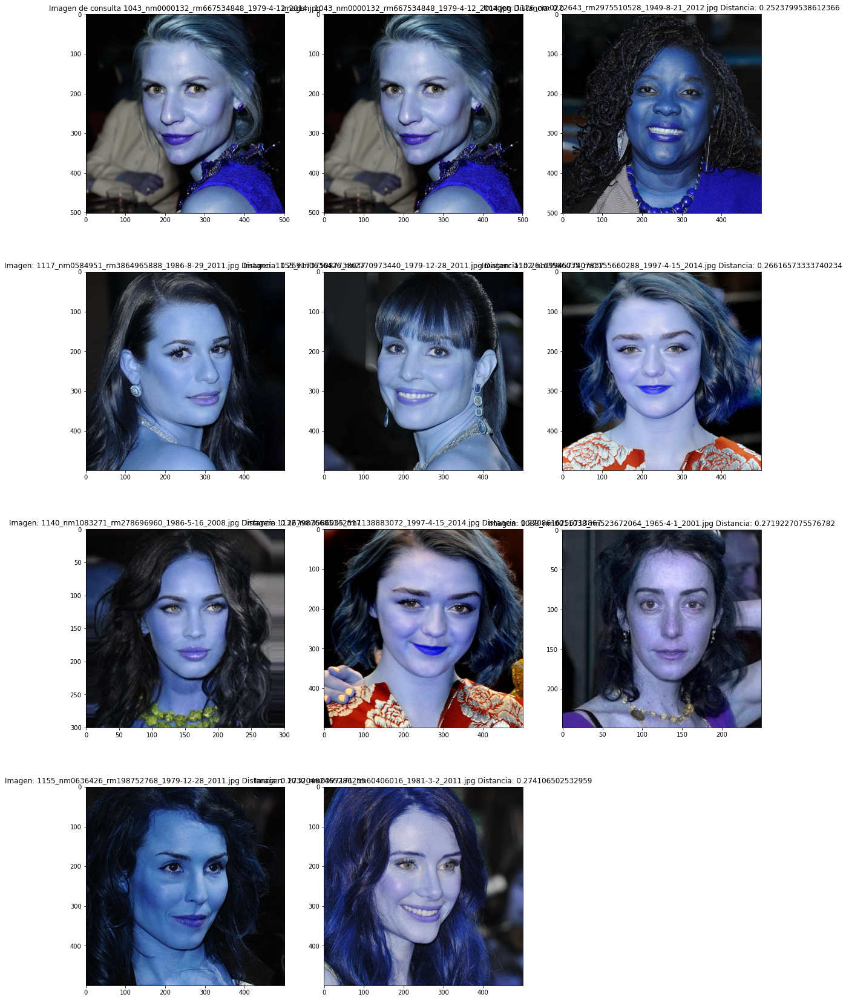

In [ ]:
plot_imagenes(GPR_dict_2_cnn_cos['img_query_path'], GPR_dict_2_cnn_cos['dist'], GPR_dict_2_cnn_cos['sorted_idx'], GPR1200_DB, directory_GPR)

#### Comparación LBP y CNN:

In [ ]:
metricasConsulta(GPR_dict_1_lbp_cos['img_query_path'], GPR1200_DB, GPR_dict_1_lbp_cos['sorted_idx'], GPR_dict_1_cnn_cos['sorted_idx'], len(GPR1200_DB), True)

Métricas de Consulta para imagen: 1002_nm1404488_rm3253067264_1991-4-10_2013.jpg

Posiciones LBP
Clase:  002 -- Posición:  1
Clase:  002 -- Posición:  14
Clase:  002 -- Posición:  165
Clase:  002 -- Posición:  328
Clase:  002 -- Posición:  1061
Clase:  002 -- Posición:  1191
Clase:  002 -- Posición:  2376
Clase:  002 -- Posición:  2541
Clase:  002 -- Posición:  2865
Clase:  002 -- Posición:  2917

Posiciones CNN
Clase:  002 -- Posición:  1
Clase:  002 -- Posición:  6
Clase:  002 -- Posición:  55
Clase:  002 -- Posición:  68
Clase:  002 -- Posición:  130
Clase:  002 -- Posición:  386
Clase:  002 -- Posición:  464
Clase:  002 -- Posición:  565
Clase:  002 -- Posición:  587
Clase:  002 -- Posición:  801

Rank LBP:  1345.9
Rank CNN:  306.3
Rank normalizado LBP:  0.1117
Rank normalizado CNN:  0.025066666666666668


In [ ]:
metricasConsulta(GPR_dict_2_lbp_cos['img_query_path'], GPR1200_DB, GPR_dict_2_lbp_cos['sorted_idx'], GPR_dict_2_cnn_cos['sorted_idx'], len(GPR1200_DB), True)

Métricas de Consulta para imagen: 1043_nm0000132_rm667534848_1979-4-12_2014.jpg

Posiciones LBP
Clase:  043 -- Posición:  1
Clase:  043 -- Posición:  47
Clase:  043 -- Posición:  91
Clase:  043 -- Posición:  240
Clase:  043 -- Posición:  271
Clase:  043 -- Posición:  297
Clase:  043 -- Posición:  2331
Clase:  043 -- Posición:  2349
Clase:  043 -- Posición:  4910
Clase:  043 -- Posición:  10680

Posiciones CNN
Clase:  043 -- Posición:  1
Clase:  043 -- Posición:  32
Clase:  043 -- Posición:  55
Clase:  043 -- Posición:  181
Clase:  043 -- Posición:  236
Clase:  043 -- Posición:  273
Clase:  043 -- Posición:  350
Clase:  043 -- Posición:  435
Clase:  043 -- Posición:  499
Clase:  043 -- Posición:  1523

Rank LBP:  2121.7
Rank CNN:  358.5
Rank normalizado LBP:  0.17635
Rank normalizado CNN:  0.029416666666666667


Observamos que nuevamente los resultados son los mismo independiente de la métrica de similitud que se implemente. Como se mencionó anteriormente, la decision recae en el tiempo de computación y costos de recursos asociados a la computación de cada distancia. Cabe decir que los rankings normalizados en este dataset, tanto para la distancia coseno como la distancia euclidiana son ligeramente peores con respecto al dataset INRIA, pero eso no significa que los resultados sean malos.

## **7. Optimización:**

### **Implementación de funciones optimizadas**

Para optimizar el proceso de búsqueda se hace uso de numba junto con métodos de comprension de lista.

In [ ]:
@nb.jit(nopython=True, fastmath=True)
def euclidean_optimized(u, v):
    return math.sqrt(sum([(a-b)**2 for a,b in zip(u,v)])) #usar comprension de lista es mas eficiente!. El modulo math es mas rapido que numpy tambien.

@nb.jit(nopython=True, fastmath=True)
def cosine_optimized(u, v):
    u_norm,v_norm = u/np.linalg.norm(u),v/np.linalg.norm(v) #usamos el modulo de numpy para las normas
    return 1-sum([a*b for a,b in zip(u_norm,v_norm)])

### **Cálculo optimizado vs cálculo normal**

In [ ]:
a = np.random.randn(500)
b = np.random.randn(500) #los vectores son como de 300 de largo, seran nuestros vectores para probar los metodos optimizados

In [ ]:
#podemos ver que el nuevo metodo optimizado es mas rapido que el original!. Se recomienda correr las celdas varias veces puesto que la primera
#vez siempre se demora mas que las demas
time1 = []
for i in range(100): #haremos un promedio de 100 muestras
    t1 = time.time()
    euclidean_dist(a,b)
    t2 = time.time()
    time1.append(t2-t1)
print("tiempo euclidiana normal: ",np.mean(np.array(time1)))

print('% RAM usado: ', psutil.virtual_memory()[2])




tiempo euclidiana normal:  0.00038084268569946286
% RAM usado:  12.4


In [ ]:
time2 = []

for i in range(100): #haremos un promedio de 100 muestras
    t1 = time.time()
    euclidean_optimized(a,b)
    t2 = time.time()
    time2.append(t2-t1)
print("tiempo euclidiana optimizado: ",np.mean(np.array(time2)))
print('% RAM usado: ', psutil.virtual_memory()[2])

tiempo euclidiana optimizado:  4.909038543701172e-06
% RAM usado:  12.3


In [ ]:
time1 = []
for i in range(100): #haremos un promedio de 100 muestras
    t1 = time.time()
    cosine_dist(a,b)
    t2 = time.time()
    time1.append(t2-t1)
print("tiempo coseno normal: ", np.mean(np.array(time1)))
print('% RAM usado: ', psutil.virtual_memory()[2])



tiempo coseno normal:  0.00011019229888916016
% RAM usado:  12.3


In [ ]:
time2 = []

for i in range(100): #haremos un promedio de 100 muestras
    t1 = time.time()
    cosine_optimized(a,b)
    t2 = time.time()
    time2.append(t2-t1)
print("tiempo coseno optimizado: ",np.mean(np.array(time2)))
print('% RAM usado: ', psutil.virtual_memory()[2])

tiempo coseno optimizado:  6.8736076354980465e-06
% RAM usado:  12.3


Lo que se puede notar con el tiempo optimizado es que este es prácticamente un orden de magnitud mas rápido que el código sin optimizar, esto se debe al actuar de numba, ya que lo que esta libreria pasa las instrucciones en python a código nativo y genera código de máquina óptimo utilizando la infraestructura del compilador LLVM. Se esperaría que al plottear las imágenes, estas se demoren mucho menos que utilizando el método no optimizado.

### **Querys usando distancias normales vs optimizadas para método CNN**

In [ ]:
#con CNN euclidiana normal
t1 = time.time()
dict_1_cnn1 = query('102300.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, euclidean_dist)
print('% RAM usado: ', psutil.virtual_memory()[2])
t2= time.time()
print("Método euclidiana no optimizada se demoró: ",t2-t1)



% RAM usado:  13.5
Método euclidiana no optimizada se demoró:  6.89505672454834


In [ ]:
#con CNN euclidiana optimizada
t3 = time.time()
dict_1_cnn2 = query('102300.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, euclidean_optimized)
print('% RAM usado: ', psutil.virtual_memory()[2])
t4 = time.time()
print("Método euclidiana optimizada se demoró: ",t4-t3)


% RAM usado:  13.5
Método euclidiana optimizada se demoró:  0.320357084274292


In [ ]:
#con CNN coseno normal
t1 = time.time()
dict_1_cnncos1 = query('102300.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, cosine_dist)
print('% RAM usado: ', psutil.virtual_memory()[2])
t2= time.time()
print("Método coseno no optimizado se demoró: ",t2-t1)


% RAM usado:  13.5
Método coseno no optimizado se demoró:  0.38688087463378906


In [ ]:
#con CNN coseno optimizado
t3 = time.time()
dict_1_cnncos2 = query('102300.jpg', 'CNN', INRIA_CNN_feature_vectors, directory_INRIA, cosine_optimized)
print('% RAM usado: ', psutil.virtual_memory()[2])
t4 = time.time()
print("Método coseno optimizado se demoró: ",t4-t3)


% RAM usado:  13.5
Método coseno optimizado se demoró:  0.3324739933013916


En el caso CNN se puede ver que los métodos optimizados obtienen generalmente un mejor tiempo  de consulta, que cuando no utilizan métodos optimizados, esto para una aplicacion en tiempo real es vital e importante, puesto que no siempre se tienen los recursos computacionales para tener grandes tiempos de espera para las imágenes. Se correlacionan estos resultados con los obtenidos en el item anterior donde se comparan los tiempos de las funciones. Cabe decir que estas celdas fueron ejecutadas varias veces y la mayor parte del tiempo el método optimizado daba mejor que el normal mientras que en el peor de los casos, los tiempos eran similares.

###**Querys usando distancias normales vs optimizadas para método LBP**

In [ ]:
#con LBP euclidiana normal
t1 = time.time()
dict_1_lbp1 = query('102300.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, euclidean_dist)
print('% RAM usado: ', psutil.virtual_memory()[2])
#plot_imagenes(dict_1_lbp1['img_query_path'], dict_1_lbp1['dist'], dict_1_lbp1['sorted_idx'], img_BD_INRIA, directory_INRIA)
t2= time.time()
print("Método euclidiana no optimizada se demoró: ",t2-t1)


% RAM usado:  13.6
Método euclidiana no optimizada se demoró:  0.5275335311889648


In [ ]:
#con LBP euclidiana optimizado
t3 = time.time()
dict_1_lbp2 = query('102300.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, euclidean_optimized)

#plot_imagenes(dict_1_lbp2['img_query_path'], dict_1_lbp2['dist'], dict_1_lbp2['sorted_idx'], img_BD_INRIA, directory_INRIA)
print('% RAM usado: ', psutil.virtual_memory()[2])
t4 = time.time()
print("Método euclidiana optimizada se demoró: ",t4-t3)


% RAM usado:  13.6
Método euclidiana optimizada se demoró:  0.2987191677093506


In [ ]:
#con LBP coseno normal
t1 = time.time()
dict_1_lbpcos1 = query('102300.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, cosine_dist)

#plot_imagenes(dict_1_lbpcos1['img_query_path'], dict_1_lbpcos1['dist'], dict_1_lbpcos1['sorted_idx'], img_BD_INRIA, directory_INRIA)
print('% RAM usado: ', psutil.virtual_memory()[2])
t2= time.time()
print("Método coseno no optimizado se demoró: ",t2-t1)


% RAM usado:  13.0
Método coseno no optimizado se demoró:  0.34583163261413574


In [ ]:
#con LBP coseno optimizado
t3 = time.time()
dict_1_lbpcos2 = query('102300.jpg', 'LBP', INRIA_LBP_feature_vectors, directory_INRIA, cosine_optimized)

#plot_imagenes(dict_1_lbpcos2['img_query_path'], dict_1_lbpcos2['dist'], dict_1_lbpcos2['sorted_idx'], img_BD_INRIA, directory_INRIA)
print('% RAM usado: ', psutil.virtual_memory()[2])
t4 = time.time()
print("Método coseno optimizada se demoró: ",t4-t3)


% RAM usado:  12.9
Método coseno optimizada se demoró:  0.3101019859313965


Similar al caso anterior, los métodos optimizados dieron mejor que los normales, además de que en este caso el método LPB se demoró mucho mas que el método con CNN, por lo tanto de esto se puede concluir que es mejor utilizar redes neuronales con decoraciones de numba para poder tener mejores tiempos de respuesta de consulta.

Cabe mencionar que los tiempos con ambos métodos, tanto LBP como con CNN varian mucho. Esto se puede deber a fluctuaciones en el procesamiento características de las librerias empleadas y no necesariamente se puede deber a las distancias optimizadas.

Cabe destacar que en todos los casos el uso de memoria no cambio, a pesar de utilizar una libreria optimizada para realizar calculos

# **Referencias**

Latif, Afshan, et al. "Content-based image retrieval and feature extraction: a comprehensive
review." Mathematical Problems in Engineering 2019 (2019)

Konstantin Schall, Kai Uwe Barthel, Nico Hezel and Klaus Jung
GPR1200: A Benchmark for General-Purpose Content-Based Image Retrieval

Herve Jegou, Matthijs Douze and Cordelia Schmid, "Hamming Embedding and Weak geometry
consistency for large scale image search", Proceedings of the 10th European conference on Computer
vision, October, 2008

Numba: https://numba.pydata.org/